In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

from sklearn.model_selection import GridSearchCV

from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import make_scorer, recall_score
pd.set_option('display.max_columns',100)    

from utils import generate_classification_report_with_recall_and_f1_score, generate_confusion_matrix, tune_model
from sklearn.ensemble import VotingClassifier

results = {}

In [3]:
df = pd.read_csv("CreditCardChurn.csv")

# Preprocessing

In [4]:
df.drop(columns=['CLIENTNUM','Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
                 'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'], inplace=True)

df['Attrition_Flag'].replace({'Existing Customer' : 0,
                              'Attrited Customer' : 1},inplace=True)

In [5]:
# Splitting the data
X = df.drop(columns=['Attrition_Flag'])
y = df['Attrition_Flag']

X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=1)

# Columns for encoding and scaling
cols_to_encode = ['Gender', 'Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category']
cols_to_scale = ['Customer_Age', 'Dependent_count', 'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
                 'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal', 'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1',
                 'Total_Trans_Amt', 'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio']

# One-hot encoding categorical variables
encoder = OneHotEncoder(drop='first', sparse_output=False)
X_train_encoded = pd.DataFrame(encoder.fit_transform(X_train[cols_to_encode]))
X_val_encoded = pd.DataFrame(encoder.transform(X_val[cols_to_encode]))
X_test_encoded = pd.DataFrame(encoder.transform(X_test[cols_to_encode]))

# Getting feature names for encoded categorical variables
encoded_feature_names = encoder.get_feature_names_out(cols_to_encode)
X_train_encoded.columns = encoded_feature_names
X_val_encoded.columns = encoded_feature_names
X_test_encoded.columns = encoded_feature_names

# Scaling numerical features
scaler = StandardScaler()
X_train_scaled = pd.DataFrame(scaler.fit_transform(X_train[cols_to_scale]), columns=cols_to_scale)
X_val_scaled = pd.DataFrame(scaler.transform(X_val[cols_to_scale]), columns=cols_to_scale)
X_test_scaled = pd.DataFrame(scaler.transform(X_test[cols_to_scale]), columns=cols_to_scale)

# Concatenating encoded categorical and scaled numerical features
X_train_final = pd.concat([X_train_scaled, X_train_encoded], axis=1)
X_val_final = pd.concat([X_val_scaled, X_val_encoded], axis=1)
X_test_final = pd.concat([X_test_scaled, X_test_encoded], axis=1)


# SMOTE

In [6]:
smote = SMOTE()

X_train_smote, y_train_smote = smote.fit_resample(X_train_final, y_train)

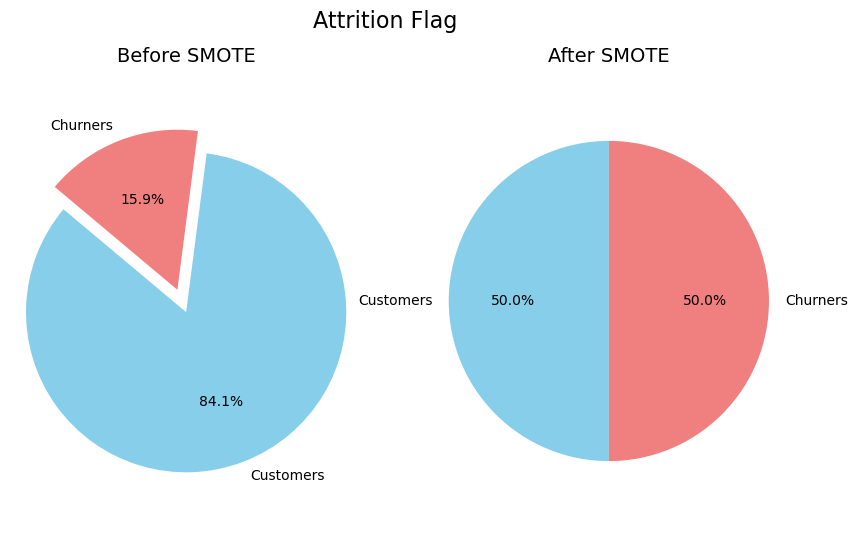

In [28]:
import matplotlib.pyplot as plt

# Data before SMOTE
labels = ['Customers', 'Churners']
sizes_before = y_train.value_counts().values
colors = ['skyblue', 'lightcoral']
explode = (0.15, 0)

# Plot before SMOTE
plt.subplot(1, 2, 1)
plt.pie(sizes_before, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140, explode=explode)
plt.title('Before SMOTE', fontsize=14)  # Updated title
plt.axis('equal')

# Data after SMOTE
sizes_after = y_train_smote.value_counts().values

# Plot after SMOTE
plt.subplot(1, 2, 2)
plt.pie(sizes_after, labels=labels, colors=colors, autopct='%1.1f%%', startangle=90)
plt.title('After SMOTE', fontsize=14)  # Updated title
plt.axis('equal')

# Set a common title for the whole figure
plt.suptitle('Attrition Flag', fontsize=16)

# Adjust layout
plt.gcf().set_size_inches(10, 6)  # Set figure size

# Show the combined plot
plt.show()


# Model Building

In [57]:
lr = LogisticRegression()
rf = RandomForestClassifier()
xgb = XGBClassifier()
lgbm = LGBMClassifier()

In [58]:
def fit_model_and_evaluate(model, model_name, X_train, y_train, X_test, y_test):
    # Fit the model
    model.fit(X_train, y_train)

    # Predict on the test set
    y_pred = model.predict(X_test)

    # Generate and print classification report
    class_1_recall, class_1_f1, accuracy = generate_classification_report_with_recall_and_f1_score(y_test, y_pred)

    # Generate and print confusion matrix
    generate_confusion_matrix(y_test, y_pred)

    # Store scores in the results dictionary
    results[model_name] = (class_1_recall, class_1_f1, accuracy)

    return class_1_recall, class_1_f1, accuracy

Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.86      0.91      1698
           1       0.53      0.84      0.65       328

    accuracy                           0.85      2026
Class 1 Recall: 0.84
Class 1 F1 Score: 0.65
Accuracy Score: 0.85


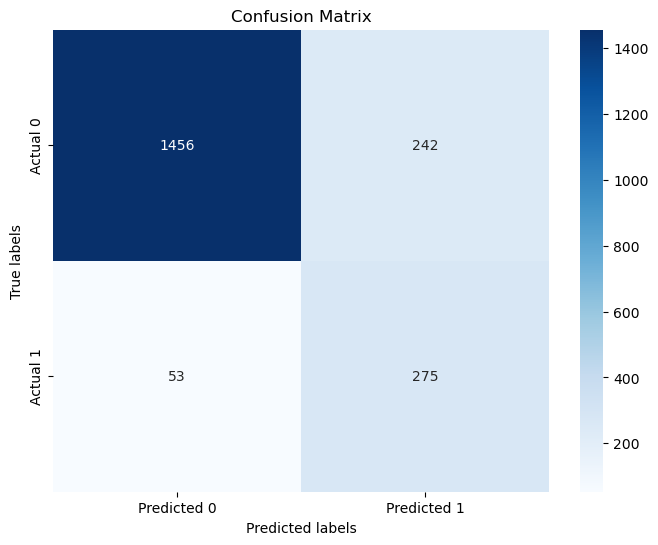

Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      1698
           1       0.88      0.83      0.85       328

    accuracy                           0.95      2026
Class 1 Recall: 0.83
Class 1 F1 Score: 0.85
Accuracy Score: 0.95


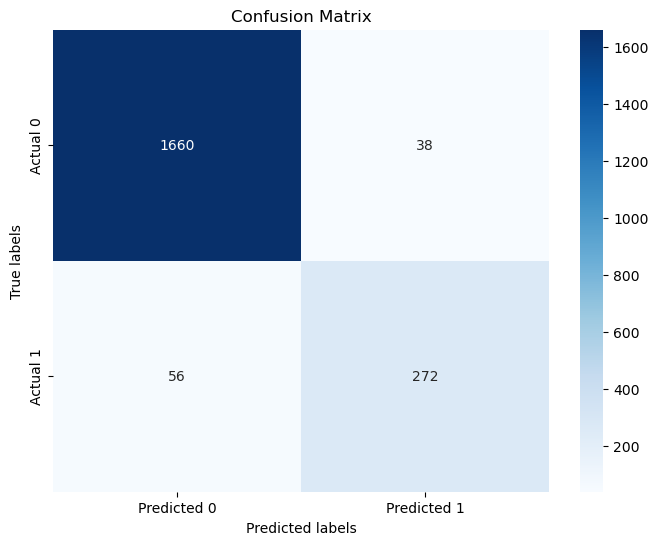

Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.99      0.98      1698
           1       0.92      0.89      0.91       328

    accuracy                           0.97      2026
Class 1 Recall: 0.89
Class 1 F1 Score: 0.91
Accuracy Score: 0.97


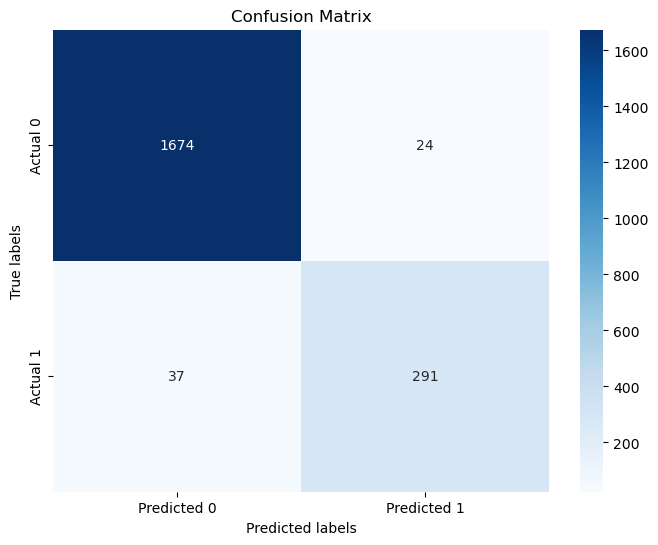

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 5107, number of negative: 5107
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001890 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7431
[LightGBM] [Info] Number of data points in the train set: 10214, number of used features: 32
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      1698
           1       0.90      0.89      0.90       328

    accuracy                           0.97      2026
Class 1 Recall: 0.89
Class 1 F1 Score: 0.9
Accuracy Score: 0.97


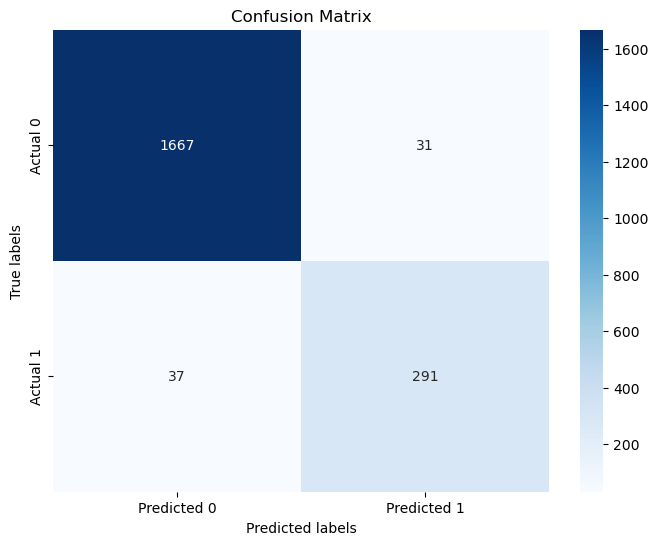

(0.89, 0.9, 0.97)

In [59]:
fit_model_and_evaluate(lr, 'Base Logistic Regression', X_train_smote, y_train_smote, X_val_final, y_val)
fit_model_and_evaluate(rf, 'Base Random Forest', X_train_smote, y_train_smote, X_val_final, y_val)
fit_model_and_evaluate(xgb, 'Base XGBoost', X_train_smote, y_train_smote, X_val_final, y_val)
fit_model_and_evaluate(lgbm, 'Base LightGBM', X_train_smote, y_train_smote, X_val_final, y_val)

## Logistic Regression

In [60]:
lr_param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],  # regularization strength
    'penalty': ['l1', 'l2'],  # penalty type
    'solver': ['liblinear', 'saga']  # optimization algorithm
}

lr = LogisticRegression(max_iter=1000)

best_lr_model = tune_model(lr, lr_param_grid, X_train_smote, y_train_smote)


Best Hyperparameters: {'C': 0.001, 'penalty': 'l1', 'solver': 'liblinear'}
Best Recall Score: 0.9071837786138834
Average Recall Score: 0.8675386837278213


Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.60      0.74      1698
           1       0.31      0.91      0.46       328

    accuracy                           0.65      2026
Class 1 Recall: 0.91
Class 1 F1 Score: 0.46
Accuracy Score: 0.65


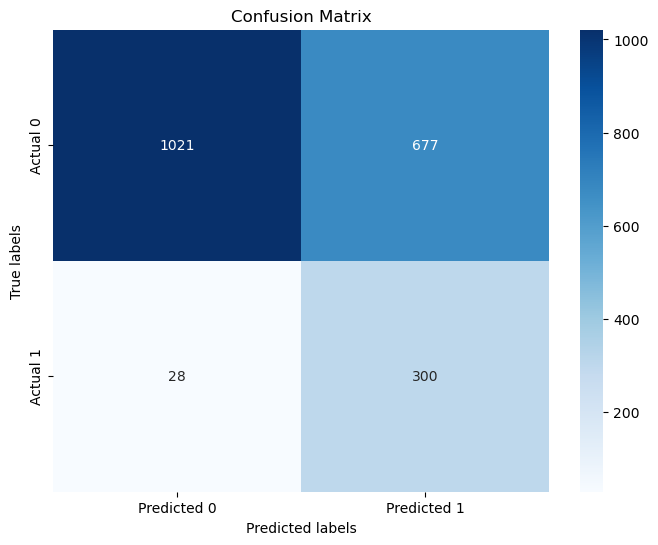

In [61]:
class_1_recall, class_1_f1, accuracy = fit_model_and_evaluate(best_lr_model, "Best Logistic Regression", X_train_smote, y_train_smote, X_val_final, y_val)

## Random Forest

In [62]:
rf_param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [None, 10],
}

best_rf_model = tune_model(rf, rf_param_grid, X_train_smote, y_train_smote)


Best Hyperparameters: {'max_depth': None, 'n_estimators': 200}
Best Recall Score: 0.978061874797549
Average Recall Score: 0.975271452146796


Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      1698
           1       0.89      0.84      0.86       328

    accuracy                           0.96      2026
Class 1 Recall: 0.84
Class 1 F1 Score: 0.86
Accuracy Score: 0.96


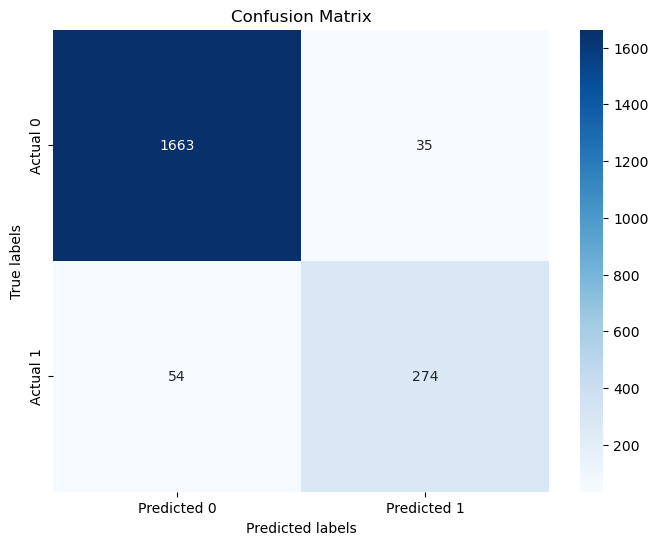

In [63]:
class_1_recall, class_1_f1, accuracy = fit_model_and_evaluate(best_rf_model, "Best Random Forest", X_train_smote, y_train_smote, X_val_final, y_val)

## XGBoost

In [64]:
xgb_param_grid = {
    'learning_rate': [0.01, 0.1, 0.2],  # learning rate
    'max_depth': [3, 5, 7],  # maximum depth of the tree
    'min_child_weight': [1, 3, 5],  # minimum sum of instance weight (hessian) needed in a child
    'subsample': [0.5, 0.7, 0.9],  # subsample ratio of the training instances
    'colsample_bytree': [0.5, 0.7, 0.9]  # subsample ratio of columns when constructing each tree
}

# Tune the XGBClassifier
best_xgb_model = tune_model(xgb, xgb_param_grid, X_train_smote, y_train_smote)

Best Hyperparameters: {'colsample_bytree': 0.5, 'learning_rate': 0.01, 'max_depth': 7, 'min_child_weight': 1, 'subsample': 0.9}
Best Recall Score: 0.9755184184953547
Average Recall Score: 0.952804303319735


Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.96      0.97      1698
           1       0.82      0.92      0.87       328

    accuracy                           0.96      2026
Class 1 Recall: 0.92
Class 1 F1 Score: 0.87
Accuracy Score: 0.96


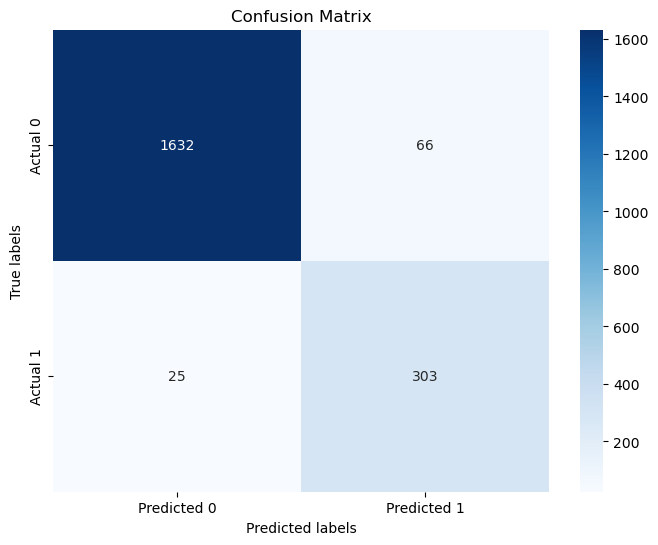

In [65]:
class_1_recall, class_1_f1, accuracy = fit_model_and_evaluate(best_xgb_model, "Best XGBClassifier", X_train_smote, y_train_smote, X_val_final, y_val)

# LightBoost

In [66]:
lgb_param_grid = {
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'min_child_weight': [1, 3, 5],
    'subsample': [0.5, 0.7, 0.9],
    'colsample_bytree': [0.5, 0.7, 0.9],
    'num_leaves': [15, 31, 63]
}

best_lgb_model = tune_model(lgbm, lgb_param_grid, X_train_smote, y_train_smote)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4086, number of negative: 4085
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000509 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 7352
[LightGBM] [Info] Number of data points in the train set: 8171, number of used features: 31
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500061 -> initscore=0.000245
[LightGBM] [Info] Start training from score 0.000245
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 4086, number of negative: 4085
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000452 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 5107, number of negative: 5107
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001754 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7431
[LightGBM] [Info] Number of data points in the train set: 10214, number of used features: 32
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.97      0.97      1698
           1       0.83      0.89      0.86       328

    accuracy                           0.95      2026
Class 1 Recall: 0.89
Class 1 F1 Score: 0.86
Accuracy Score: 0.95


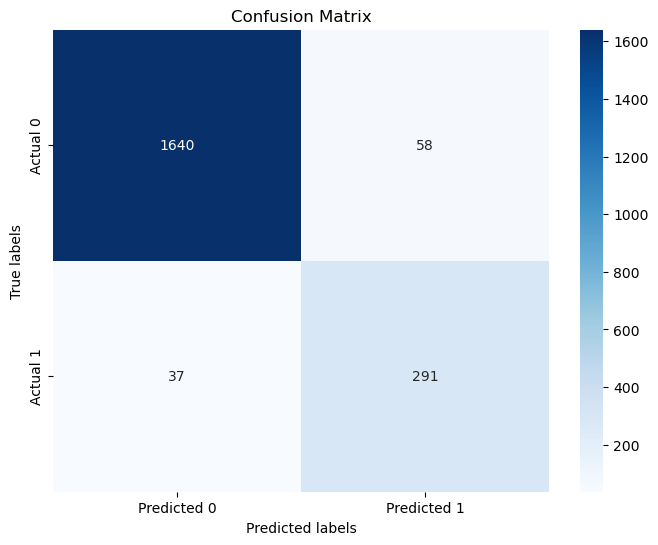

In [67]:
class_1_recall, class_1_f1, accuracy = fit_model_and_evaluate(best_lgb_model, "Best LightGBMClassifier", X_train_smote, y_train_smote, X_val_final, y_val)

In [68]:
print("{:<30} {:<15} {:<15} {:<15}".format('Model', 'Class 1 Recall', 'Class 1 F1', 'Accuracy'))
print("-" * 75)

# Print each row in a formatted manner
for model, scores in results.items():
    print("{:<30} {:<15} {:<15} {:<15}".format(model, scores[0], scores[1], scores[2]))

Model                          Class 1 Recall  Class 1 F1      Accuracy       
---------------------------------------------------------------------------
Base Logistic Regression       0.84            0.65            0.85           
Base Random Forest             0.83            0.85            0.95           
Base XGBoost                   0.89            0.91            0.97           
Base LightGBM                  0.89            0.9             0.97           
Best Logistic Regression       0.91            0.46            0.65           
Best Random Forest             0.84            0.86            0.96           
Best XGBClassifier             0.92            0.87            0.96           
Best LightGBMClassifier        0.89            0.86            0.95           


In [69]:
xgb_param_grid_fine_tune = {
    'learning_rate': [0.01, 0.05, 0.1],  # Adjusted learning rates
    'max_depth': [6, 7, 8],  # Adjusted maximum depths
    'min_child_weight': [1, 2, 3],  # Adjusted min_child_weight
    'subsample': [0.8, 0.9, 1.0],  # Adjusted subsample values
    'colsample_bytree': [0.4, 0.5, 0.6]  # Adjusted colsample_bytree values
}

best_xgb_model = tune_model(xgb, xgb_param_grid_fine_tune, X_train_smote, y_train_smote)

Best Hyperparameters: {'colsample_bytree': 0.6, 'learning_rate': 0.01, 'max_depth': 8, 'min_child_weight': 1, 'subsample': 1.0}
Best Recall Score: 0.9784565226141441
Average Recall Score: 0.9673551708800823


Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.96      0.97      1698
           1       0.83      0.89      0.86       328

    accuracy                           0.95      2026
Class 1 Recall: 0.89
Class 1 F1 Score: 0.86
Accuracy Score: 0.95


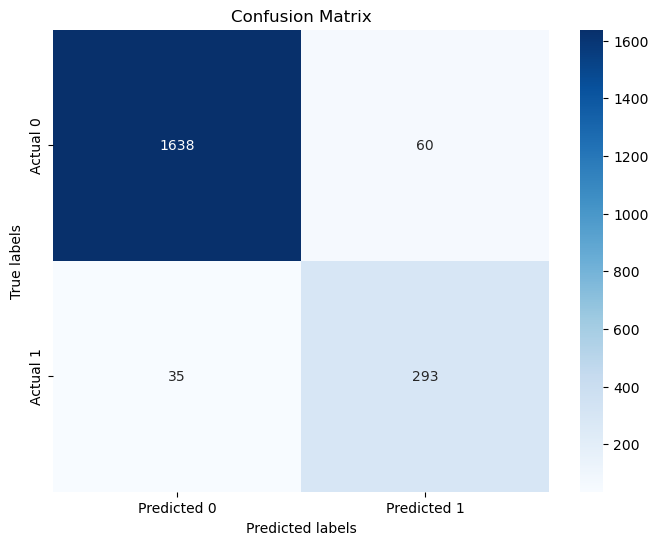

In [70]:
class_1_recall, class_1_f1, accuracy = fit_model_and_evaluate(best_xgb_model, "Best XGBClassifier Tuned", X_train_smote, y_train_smote, X_val_final, y_val)

In [71]:
lgb_param_grid_fine_tune = {
    'learning_rate': [0.01, 0.05, 0.1],  
    'max_depth': [6, 7, 8],  
    'min_child_weight': [1, 2, 3],  
    'subsample': [0.8, 0.9, 1.0],  
    'colsample_bytree': [0.4, 0.5, 0.6],
    'num_leaves': [31, 63, 127]  # Added num_leaves parameter
}

best_lgb_model = tune_model(lgbm, lgb_param_grid_fine_tune, X_train_smote, y_train_smote)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 4086, number of negative: 4085
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000344 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 7352
[LightGBM] [Info] Number of data points in the train set: 8171, number of used features: 31
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500061 -> initscore=0.000245
[LightGBM] [Info] Start training from score 0.000245
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_le

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 5107, number of negative: 5107
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000478 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 7431
[LightGBM] [Info] Number of data points in the train set: 10214, number of used features: 32
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

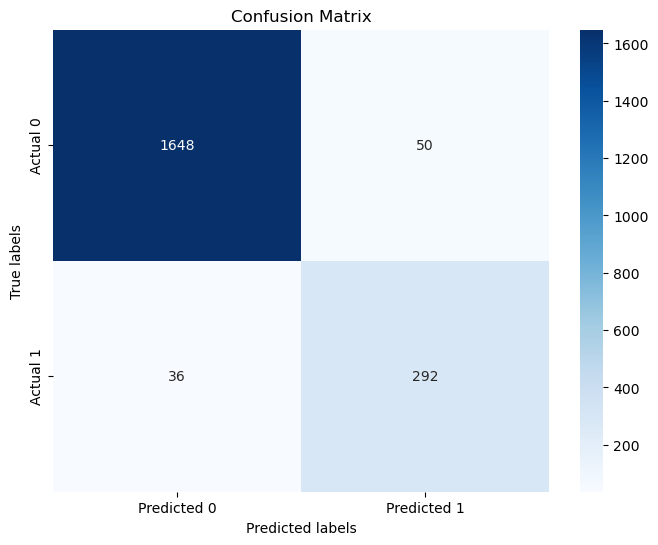

In [72]:
class_1_recall, class_1_f1, accuracy = fit_model_and_evaluate(best_lgb_model, "Best LGBMClassifier Tuned", X_train_smote, y_train_smote, X_val_final, y_val)

In [73]:
print("{:<30} {:<15} {:<15} {:<15}".format('Model', 'Class 1 Recall', 'Class 1 F1', 'Accuracy'))
print("-" * 75)

# Print each row in a formatted manner
for model, scores in results.items():
    print("{:<30} {:<15} {:<15} {:<15}".format(model, scores[0], scores[1], scores[2]))

Model                          Class 1 Recall  Class 1 F1      Accuracy       
---------------------------------------------------------------------------
Base Logistic Regression       0.84            0.65            0.85           
Base Random Forest             0.83            0.85            0.95           
Base XGBoost                   0.89            0.91            0.97           
Base LightGBM                  0.89            0.9             0.97           
Best Logistic Regression       0.91            0.46            0.65           
Best Random Forest             0.84            0.86            0.96           
Best XGBClassifier             0.92            0.87            0.96           
Best LightGBMClassifier        0.89            0.86            0.95           
Best XGBClassifier Tuned       0.89            0.86            0.95           
Best LGBMClassifier Tuned      0.89            0.87            0.96           


In [74]:
from tabulate import tabulate

# Convert dictionary to list of lists
table_data = []
for model, scores in results.items():
    table_data.append([model, *scores])

# Print table
print(tabulate(table_data, headers=['Model', 'Class 1 Recall', 'Class 1 F1', 'Accuracy'], tablefmt='github'))

| Model                     |   Class 1 Recall |   Class 1 F1 |   Accuracy |
|---------------------------|------------------|--------------|------------|
| Base Logistic Regression  |             0.84 |         0.65 |       0.85 |
| Base Random Forest        |             0.83 |         0.85 |       0.95 |
| Base XGBoost              |             0.89 |         0.91 |       0.97 |
| Base LightGBM             |             0.89 |         0.9  |       0.97 |
| Best Logistic Regression  |             0.91 |         0.46 |       0.65 |
| Best Random Forest        |             0.84 |         0.86 |       0.96 |
| Best XGBClassifier        |             0.92 |         0.87 |       0.96 |
| Best LightGBMClassifier   |             0.89 |         0.86 |       0.95 |
| Best XGBClassifier Tuned  |             0.89 |         0.86 |       0.95 |
| Best LGBMClassifier Tuned |             0.89 |         0.87 |       0.96 |


## Ensemble Models

In [75]:
# Base XGB
base_xgb = XGBClassifier()

# Base LGBM
base_lgbm = LGBMClassifier()

# Best XGBoost
xgb_model = XGBClassifier(colsample_bytree=0.5,
                          learning_rate=0.01,
                          max_depth=7,
                          min_child_weight=1,
                          subsample=0.9)

# Best LGBM
lgbm_model = LGBMClassifier(colsample_bytree=0.6,
                             learning_rate=0.05,
                             max_depth=8,
                             min_child_weight=1,
                             num_leaves=127,
                             subsample=0.8)

In [76]:
soft_voting_base = VotingClassifier(estimators=[
    ('xgb', base_xgb),
    ('lgbm', base_lgbm)
], voting='soft')

class_1_recall, class_1_f1, accuracy = fit_model_and_evaluate(soft_voting_base, "Ensemble Base Models", X_train_smote, y_train_smote, X_val_final, y_val)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 5107, number of negative: 5107
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001705 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7431
[LightGBM] [Info] Number of data points in the train set: 10214, number of used features: 32
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      1698
           1       0.92      0.89      0.90       328

    accuracy                           0.97      2026
Class 1 Recall: 0.89
Class 1 F1 Score: 0.9
Accuracy Score: 0.97


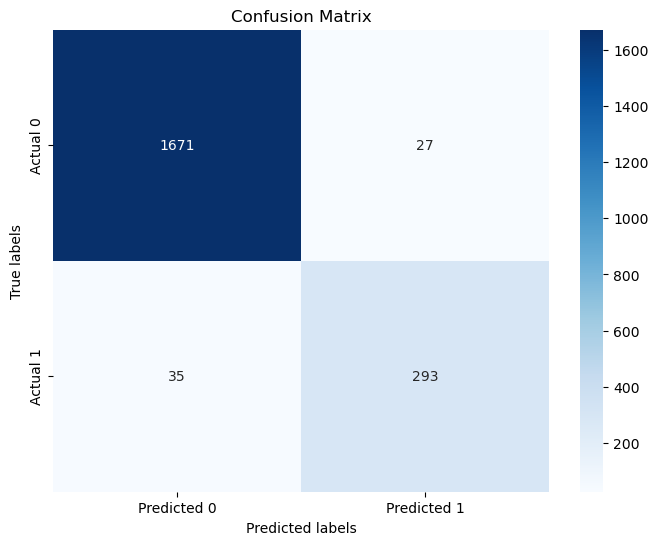

In [77]:
soft_voting_tuned = VotingClassifier(estimators=[
    ('xgb_tuned', xgb_model),
    ('lgbm_tuned', lgbm_model)
], voting='soft')

class_1_recall, class_1_f1, accuracy = fit_model_and_evaluate(soft_voting_tuned, "Ensemble Tuned Models", X_train_smote, y_train_smote, X_val_final, y_val)

In [ ]:
soft_voting_xgb = VotingClassifier(estimators=[
    ('base xgb', base_xgb),
    ('best xgb', xgb_model)
], voting='soft')

class_1_recall, class_1_f1, accuracy = fit_model_and_evaluate(soft_voting_xgb, "Ensemble XGB Models", X_train_smote, y_train_smote, X_val_final, y_val)

In [81]:
from tabulate import tabulate

# Convert dictionary to list of lists
table_data = []
for model, scores in results.items():
    table_data.append([model, *scores])

# Print table
print(tabulate(table_data, headers=['Model', 'Class 1 Recall', 'Class 1 F1', 'Accuracy'], tablefmt='github'))

| Model                     |   Class 1 Recall |   Class 1 F1 |   Accuracy |
|---------------------------|------------------|--------------|------------|
| Base Logistic Regression  |             0.84 |         0.65 |       0.85 |
| Base Random Forest        |             0.83 |         0.85 |       0.95 |
| Base XGBoost              |             0.89 |         0.91 |       0.97 |
| Base LightGBM             |             0.89 |         0.9  |       0.97 |
| Best Logistic Regression  |             0.91 |         0.46 |       0.65 |
| Best Random Forest        |             0.84 |         0.86 |       0.96 |
| Best XGBClassifier        |             0.92 |         0.87 |       0.96 |
| Best LightGBMClassifier   |             0.89 |         0.86 |       0.95 |
| Best XGBClassifier Tuned  |             0.89 |         0.86 |       0.95 |
| Best LGBMClassifier Tuned |             0.89 |         0.87 |       0.96 |
| Ensemble Base Models      |             0.89 |         0.9  |       0.97 |

| Model                     |   Class 1 Recall |   Class 1 F1 |   Accuracy |
|---------------------------|------------------|--------------|------------|
| Base Logistic Regression  |             0.84 |         0.65 |       0.85 |
| Base Random Forest        |             0.83 |         0.85 |       0.95 |
| Base XGBoost              |             0.89 |         0.91 |       0.97 |
| Base LightGBM             |             0.89 |         0.9  |       0.97 |
| Best Logistic Regression  |             0.91 |         0.46 |       0.65 |
| Best Random Forest        |             0.84 |         0.86 |       0.96 |
| Best XGBClassifier        |             0.92 |         0.87 |       0.96 |
| Best LightGBMClassifier   |             0.89 |         0.86 |       0.95 |
| Best XGBClassifier Tuned  |             0.89 |         0.86 |       0.95 |
| Best LGBMClassifier Tuned |             0.89 |         0.87 |       0.96 |
| Ensemble Base Models      |             0.89 |         0.9  |       0.97 |
| Ensemble Tuned Models     |             0.9  |         0.89 |       0.96 |
| Ensemble XGB Models       |             0.89 |         0.9  |       0.97 |

## A lot of these models have very similar performance. In a business setting, the best model could vary from person to person. Some suggestions are to pick:

- ### Best XGB, for identifying as much churners as possible.
- ### Base XGB, for an overall well-rounded model performance
- ### Ensemble Tuned Model, for a well-rounded performance weighted towards identifying more churners